In [1]:
Sys.setenv(RETICULATE_PYTHON = "/lustre/home/jasonliao/miniconda3/envs/r/bin/python")
library(reticulate)
source("../Extend.R")
library(tidyverse)
library(SnapATAC)
library(leiden)
library("rtracklayer")
library(bbplot)
library(Signac)
library(pheatmap)
library(motifmatchr)
library(ggpubr)
library(altair)
library(patchwork)
library(ChIPseeker)
library(ggseqlogo)

── Attaching packages ────────────────────────────────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.1     ✔ purrr   1.0.1
✔ tibble  3.1.8     ✔ dplyr   1.1.0
✔ tidyr   1.3.0     ✔ stringr 1.5.0
✔ readr   2.1.3     ✔ forcats 1.0.0
Warning message:
“package ‘tibble’ was built under R version 4.2.1”
Warning message:
“package ‘purrr’ was built under R version 4.2.2”
Warning message:
“package ‘stringr’ was built under R version 4.2.2”
── Conflicts ───────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
Loading required package: Matrix

Warning message:
“package ‘Matrix’ was built under R version 4.2.2”

Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loading required package: rhdf5

Warning message:
“package ‘rhdf5’ was built under R version 4.2.2”
Warning message:
“no DISPLAY variable so Tk

In [3]:
TP12 = createSnap(file='./TP12.fragments.snap' , sample="TP12",num.cores=1)
TP12.metadata <- read.csv(
  file = "../raw_data/TP12/deconvoluted_data/final/alignments.possorted.tagged.QCstats.csv",
  header = TRUE,
  row.names = 1
)

TP12.metadata$mito.pct <- TP12.metadata$totalMitoFrags / TP12.metadata$librarySize* 100
row.names(TP12.metadata) <- toupper(row.names(TP12.metadata))
TP12.sel <- TP12.metadata[which(TP12.metadata$tssProportion > 0.15  & TP12.metadata$uniqueNuclearFrags > 10000 & TP12.metadata$mito.pct < 10),] 
TP12.fil = TP12[which(TP12@barcode %in% rownames(TP12.sel))]
TP12.fil@metaData = TP12.metadata[(TP12.fil@barcode),]

Epoch: reading the barcode session ...



In [4]:
TP13 = createSnap(file='./TP13.fragments.snap' , sample="TP13",num.cores=1)
TP13.metadata <- read.csv(
  file = "../raw_data/TP13/deconvoluted_data/final/alignments.possorted.tagged.QCstats.csv",
  header = TRUE,
  row.names = 1
)

TP13.metadata$mito.pct <- TP13.metadata$totalMitoFrags / TP13.metadata$librarySize* 100
row.names(TP13.metadata) <- toupper(row.names(TP13.metadata))
TP13.sel <- TP13.metadata[which(TP13.metadata$tssProportion > 0.15  & TP13.metadata$uniqueNuclearFrags > 10000 & TP13.metadata$mito.pct < 10),] 
TP13.fil = TP13[which(TP13@barcode %in% rownames(TP13.sel))]
TP13.fil@metaData = TP13.metadata[(TP13.fil@barcode),]

Epoch: reading the barcode session ...



In [5]:
TP14 = createSnap(file='./TP14.fragments.snap' , sample="TP14",num.cores=1)
TP14.metadata <- read.csv(
  file = "../raw_data/TP14/deconvoluted_data/final/alignments.possorted.tagged.QCstats.csv",
  header = TRUE,
  row.names = 1
)

TP14.metadata$mito.pct <- TP14.metadata$totalMitoFrags / TP14.metadata$librarySize* 100
row.names(TP14.metadata) <- toupper(row.names(TP14.metadata))
TP14.sel <- TP14.metadata[which(TP14.metadata$tssProportion > 0.15  & TP14.metadata$uniqueNuclearFrags > 10000 & TP14.metadata$mito.pct < 10),] 
TP14.fil = TP14[which(TP14@barcode %in% rownames(TP14.sel))]
TP14.fil@metaData = TP14.metadata[(TP14.fil@barcode),]

Epoch: reading the barcode session ...



In [6]:
TP15 = createSnap(file='./TP15.fragments.snap' , sample="TP15",num.cores=1)
TP15.metadata <- read.csv(
  file = "../raw_data/TP15/deconvoluted_data/final/alignments.possorted.tagged.QCstats.csv",
  header = TRUE,
  row.names = 1
)

TP15.metadata$mito.pct <- TP15.metadata$totalMitoFrags / TP15.metadata$librarySize* 100
row.names(TP15.metadata) <- toupper(row.names(TP15.metadata))
TP15.sel <- TP15.metadata[which(TP15.metadata$tssProportion > 0.15  & TP15.metadata$uniqueNuclearFrags > 10000 & TP15.metadata$mito.pct < 10),] 
TP15.fil = TP15[which(TP15@barcode %in% rownames(TP15.sel))]
TP15.fil@metaData = TP15.metadata[(TP15.fil@barcode),]

Epoch: reading the barcode session ...



In [19]:
source('new_snapRbind.R') 
source("jaccard-class.R")
source("dimReduct-class.R")
source("kgraph-class.R")
source("dimReduct-class.R")
source("dimReduct-class.R")
environment(new_snapRbind) = asNamespace('SnapATAC')
assignInNamespace("snapRbind", new_snapRbind, ns = "SnapATAC")

In [20]:
# saveRDS(x.sp, "./x.sp.Reduce.rds")

In [22]:
x.sp <- list(TP12,TP13,TP14,TP15)
x.sp = Reduce(snapRbind, x.sp)
x.sp = addBmatToSnap(x.sp, bin.size=5000, num.cores=1)
x.sp = makeBinary(x.sp, mat="bmat")

Epoch: reading cell-bin count matrix session ...



In [23]:
gc()
x.sp

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,11213844,598.9,19589798,1046.3,13558211,724.1
Vcells,205314475,1566.5,571153508,4357.6,634317857,4839.5


number of barcodes: 10343
number of bins: 546206
number of genes: 0
number of peaks: 0
number of motifs: 0

In [24]:
rownames(x.sp@metaData)[x.sp@sample == "TP12"] <- paste("TP12",TP12@barcode[TP12@sample == "TP12"],sep="#")
rownames(x.sp@metaData)[x.sp@sample == "TP13"] <- paste("TP13",TP13@barcode[TP13@sample == "TP13"],sep="#")
rownames(x.sp@metaData)[x.sp@sample == "TP14"] <- paste("TP14",TP14@barcode[TP14@sample == "TP14"],sep="#")
rownames(x.sp@metaData)[x.sp@sample == "TP15"] <- paste("TP15",TP15@barcode[TP15@sample == "TP15"],sep="#")

In [25]:
x.sp

number of barcodes: 10343
number of bins: 546206
number of genes: 0
number of peaks: 0
number of motifs: 0

In [26]:
## Filter doublets
doublet.info <- readRDS("../gonad_4sample_nodoublet.rds")

In [27]:
x.sp = x.sp[which(rownames(x.sp@metaData) %in% toupper(rownames(doublet.info)))]
rownames(doublet.info) <- toupper(rownames(doublet.info))
doublet.info$cellname <- rownames(doublet.info)
x.sp@metaData$cellname <- rownames(x.sp@metaData)
x.sp@metaData <- cbind(x.sp@metaData %>% arrange(cellname), doublet.info %>% as.data.frame() %>% arrange(cellname))

In [28]:
x.sp
x.sp[x.sp@metaData$TSSEnrichment > 10 ]

number of barcodes: 9702
number of bins: 546206
number of genes: 0
number of peaks: 0
number of motifs: 0

number of barcodes: 9494
number of bins: 546206
number of genes: 0
number of peaks: 0
number of motifs: 0

In [29]:
x.sp <- x.sp[x.sp@metaData$TSSEnrichment > 10 ]

In [1]:
library(GenomicRanges);
# system("wget http://mitra.stanford.edu/kundaje/akundaje/release/blacklists/mm10-mouse/mm10.blacklist.bed.gz")
black_list = read.table("mm10.blacklist.bed.gz");
black_list.gr = GRanges(
    black_list[,1], 
    IRanges(black_list[,2], black_list[,3])
  );
idy = queryHits(findOverlaps(x.sp@feature, black_list.gr));
if(length(idy) > 0){x.sp = x.sp[,-idy, mat="bmat"]};
x.sp
chr.exclude = seqlevels(x.sp@feature)[grep("random|chrM", seqlevels(x.sp@feature))];
idy = grep(paste(chr.exclude, collapse="|"), x.sp@feature);
if(length(idy) > 0){x.sp = x.sp[,-idy, mat="bmat"]};
x.sp
bin.cov = log10(Matrix::colSums(x.sp@bmat)+1)
hist(
    bin.cov[bin.cov > 0], 
    xlab="log10(bin cov)", 
    main="log10(Bin Cov)", 
    col="lightblue", 
    xlim=c(0, 5)
  )
bin.cutoff = quantile(bin.cov[bin.cov > 0], 0.9);
idy = which(bin.cov <= bin.cutoff & bin.cov > 1);
x.sp = x.sp[, idy, mat="bmat"];
x.sp

In [2]:
x.sp = runDiffusionMaps(
    obj=x.sp,
    input.mat="bmat", 
    num.eigs=30
  )
plotDimReductPW(
    obj=x.sp, 
    eigs.dims=1:30,
    point.size=0.3,
    point.color="grey",
    point.shape=19,
    point.alpha=0.6,
    down.sample=5000,
    pdf.file.name=NULL, 
    pdf.height=7, 
    pdf.width=7
  )


In [32]:
# orignial 12 
x.sp = runKNN(
   obj=x.sp,
   eigs.dims=1:14,
# weight.by.lambda=TRUE,
   k=15
  )

# resolution 0.7 5 cluster
# resolution 0.75 6 cluster

x.sp=runCluster(
    obj=x.sp,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 0.75

)

x.sp@metaData$cluster = x.sp@cluster;

x.sp = runViz(
    obj=x.sp, 
    tmp.folder=tempdir(),
    dims=2,
    eigs.dims=1:14, 
    method="umap",
    seed.use=8
  )

Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coercion to integer range”
Warning message in paste(sig, collapse = "#"):
“NAs introduced by coer

In [8]:
x.sp=runCluster(
    obj=x.sp,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 0.8

)

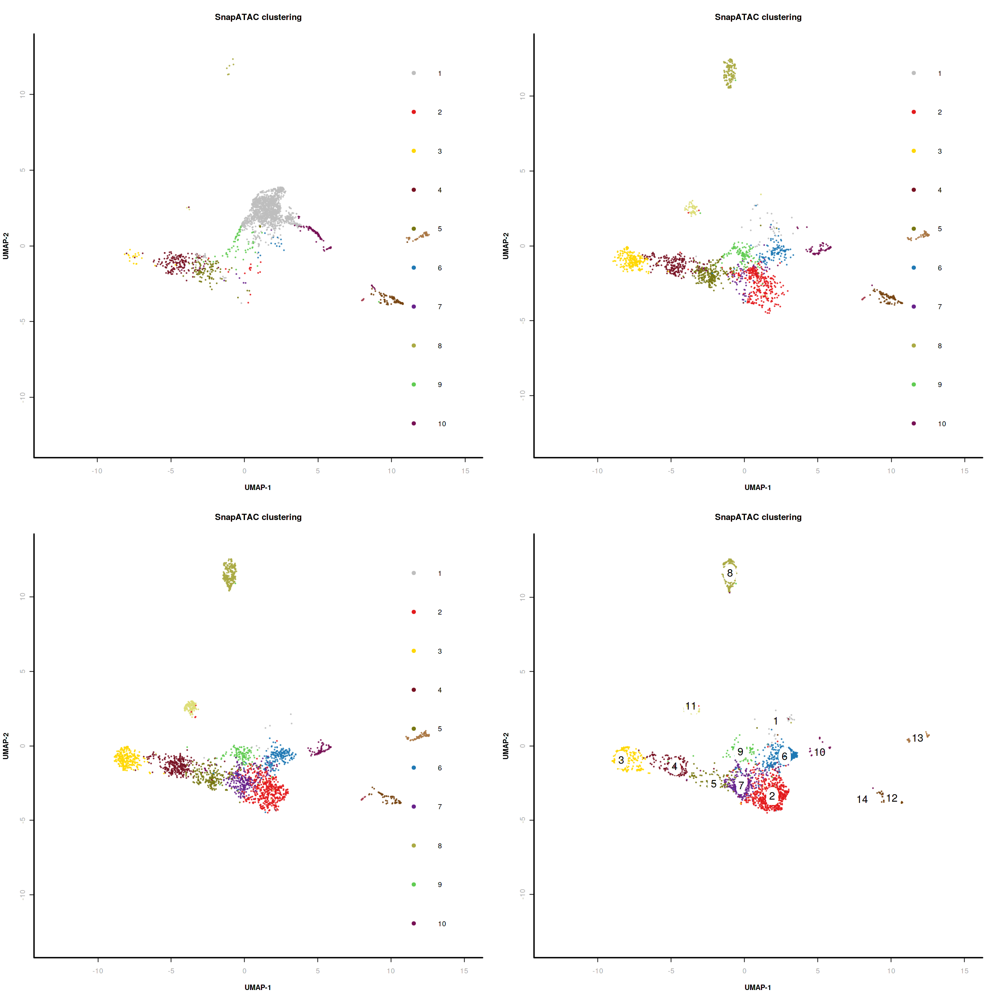

In [463]:
options(repr.plot.width=20,repr.plot.height=20)
par(mfrow= c(2,2))
# par(mfrow= c(2,2))
plotViz(
    obj=x.sp[x.sp@sample == "TP12",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp[x.sp@sample == "TP12",]@cluster, 
    point.size=0.2, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=TRUE
  )
plotViz(
    obj=x.sp[x.sp@sample == "TP13",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp[x.sp@sample == "TP13",]@cluster, 
    point.size=0.2, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=TRUE
  )
plotViz(
    obj=x.sp[x.sp@sample == "TP14",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp[x.sp@sample == "TP14",]@cluster, 
    point.size=0.2, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=TRUE
  )
plotViz(
    obj=x.sp[x.sp@sample == "TP15",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp[x.sp@sample == "TP15",]@cluster, 
    point.size=0.2, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=TRUE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE
  )

In [9]:
# marker.genes <- c(
# #     "Sox9","Foxl2", "Insl3", "Hsd3b1", "Pdgfra", "Wnt5a", "Nr2f2","Dazl","Wt1",
# #            "Cd7",","Tcf21","Acta2","Myh11","Dmrt1","Star",
#              "Cd7","Col1a1",
#     "Slc4a1", # C15
#                   "Rbfox1","Cdh13", # C13
#                   "Egfl7",# C5
#                   "Cd86","Cd33", # C16
#                   "Hoxa3"
#                  )
marker.genes <- c("Wt1","Adh1","Nr2f1","Uty","Ddx3y","Sf1","Nr5a1")

In [86]:
# x.sp <- readRDS(file="./Results/RDS/20200416.x.sp-CTRL_G9a_EMT-filteredV3.rds")
## Create Granges of promoter+genebody 
## Gene body + promoter 
library(EnsDb.Mmusculus.v79)
gene.coords <- genes(EnsDb.Mmusculus.v79, filter = ~ gene_biotype == "protein_coding")
seqlevelsStyle(gene.coords) <- 'UCSC'
genebody.coords <- keepStandardChromosomes(gene.coords, pruning.mode = 'coarse')
genebodyandpromoter.coords <- Extend(x = gene.coords, upstream = 2000, downstream = 0)
genebodyandpromoter.coords$name <- make.unique(genebodyandpromoter.coords$gene_name,sep = "_")
genebodyandpromoter.coords$name[which(genebodyandpromoter.coords$name == "")] <- "Unknown"
# saveRDS(genebodyandpromoter.coords,file="Results/RDS/genebodyandpromoter.coords.mm10.rds")

Loading required package: ensembldb

Loading required package: GenomicFeatures

Loading required package: AnnotationDbi

Loading required package: Biobase

Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'browseVignettes()'. To cite Bioconductor, see
    'citation("Biobase")', and for packages 'citation("pkgname")'.



Attaching package: ‘AnnotationDbi’


The following object is masked from ‘package:dplyr’:

    select


Loading required package: AnnotationFilter


Attaching package: 'ensembldb'


The following object is masked from 'package:dplyr':

    filter


The following object is masked from 'package:stats':

    filter


Warning message in valid.GenomicRanges.seqinfo(x, suggest.trim = TRUE):
"GRanges object contains 3 out-of-bound ranges located on sequences
  JH584293.1, JH584295.1, and JH584296.1. Note that ranges located on a
  sequence whose length is unknown (NA) or on a circular sequence are not
  considered out-of-bound (use seqlengths

In [ ]:
genes.gr <- genebodyandpromoter.coords

genes.sel.gr <- genes.gr[which(genes.gr$name %in% marker.genes)];
# re-add the cell-by-bin matrix to the snap object;
x.sp = addBmatToSnap(x.sp);
x.sp = createGmatFromMat(
    obj=x.sp, 
    input.mat="bmat",
    genes=genes.sel.gr,
    do.par=TRUE,
    num.cores=10
  );
# normalize the cell-by-gene matrix
x.sp = scaleCountMatrix(
    obj=x.sp, 
    cov=x.sp@metaData$nFrags,
    mat="gmat",
    method = "RPM"
  )
# saveRDS(x.sp,file="./Results/RDS/x.sp.filterhighTSS.v4.bmap.pmap.mmat.gmat.rds")
# smooth the cell-by-gene matrix
x.sp = runMagic(
    obj=x.sp,
    input.mat="gmat",
    step.size=3
  );



for(i in 1:9){
    plotFeatureSingle(
        obj=x.sp,
        feature.value=x.sp@gmat[, marker.genes[i]],
        method="umap", 
        main=marker.genes[i],
        point.size=0.01, 
        point.shape=19, 
        down.sample=10000,
        quantiles=c(0, 1)
  )};


In [127]:
chrX.gr <- GRanges(
    seqnames = c("chrX"),
    ranges = IRanges(103465020, end = 103487145),
    strand = c("-"),
    score = 1,
name = "chrX")
chrX.gr

# re-add the cell-by-bin matrix to the snap object;
x.sp = addBmatToSnap(x.sp);
x.sp = createGmatFromMat(
    obj=x.sp, 
    input.mat="bmat",
    genes=chrX.gr,
    do.par=TRUE,
    num.cores=10
  );
# x.sp = scaleCountMatrix(
#     obj=x.sp, 
#     cov=x.sp@metaData$nFrags,
#     mat="gmat",
#     method = "RPM"
#   )

GRanges object with 1 range and 2 metadata columns:
      seqnames              ranges strand |     score        name
         <Rle>           <IRanges>  <Rle> | <numeric> <character>
  [1]     chrX 103465020-103487145      - |         1        chrX
  -------
  seqinfo: 1 sequence from an unspecified genome; no seqlengths

Epoch: reading cell-bin count matrix session ...



In [126]:
chrY.gr <- GRanges(
    seqnames = c("chrY"),
#     ranges = IRanges(712660, end = 1398697),
    #chrY:491,490-12,778,724  90,669,338
    ranges = IRanges(491490, end = 90669338),
    strand = c("-"),
    score = 1,
name = "chrY")
chrY.gr

# re-add the cell-by-bin matrix to the snap object;
x.sp = addBmatToSnap(x.sp);
x.sp = createGmatFromMat(
    obj=x.sp, 
    input.mat="bmat",
    genes=chrY.gr,
    do.par=TRUE,
    num.cores=10
  );

# saveRDS(x.sp,file="./Results/RDS/x.sp.filterhighTSS.v4.bmap.pmap.mmat.gmat.rds")
#smooth the cell-by-gene matrix
# x.sp = runMagic(
#     obj=x.sp,
#     input.mat="gmat",
#     step.size=3
#   );






GRanges object with 1 range and 2 metadata columns:
      seqnames          ranges strand |     score        name
         <Rle>       <IRanges>  <Rle> | <numeric> <character>
  [1]     chrY 491490-90669338      - |         1        chrY
  -------
  seqinfo: 1 sequence from an unspecified genome; no seqlengths

Epoch: reading cell-bin count matrix session ...



In [134]:
#normalize the cell-by-gene matrix
# x.sp = scaleCountMatrix(
#     obj=x.sp, 
#     cov=x.sp@metaData$nFrags,
#     mat="gmat",
#     method = "RPM"
#   )

In [63]:
x.sp@metaData$chrY <- x.sp@gmat[, "chrY"]

In [64]:
x.sp@metaData$chrY %>% head()

[1]  670.8408  383.8906  669.6130  141.7485  151.2345 1281.3748

In [444]:
allcell.chr1.magic <- x.sp@gmat[, "chrY"]

In [448]:
allcell.chrY.quant <- as.matrix(x.sp@gmat) %>% as.data.frame()
allcell.chrY.quant$chrY.magic <- as.matrix(x.sp@gmat[, "chrY"]) %>% as.data.frame()
# saveRDS(chrY.quant,file="ChrY.quant.snap.rds")

# x.sp.fil@metaData <- 
# x.sp@metaData <- cbind(x.sp@metaData, allcell.chrY.quant)


In [ ]:

x.sp.fil@metaData$chrY.magic <- x.sp.fil@metaData$V1
x.sp.fil@metaData$V1 <- NULL

In [462]:
x.sp@metaData$chrY <- x.sp@gmat[, "chrY"]
x.sp@metaData <- cbind(x.sp@metaData,x.sp@umap,x.sp@smat@dmat[,1:14])
x.sp@metaData <- x.sp@metaData %>% as.data.frame()




In [465]:
x.sp@metaData$cluster <- x.sp@cluster
saveRDS(x.sp@metaData,"gonad.4sampls_refined_snapatac.metadata.rds")

In [65]:
x.sp@umap[,1] <- metadata$`umap-1`
x.sp@umap[,2] <- metadata$`umap-2`
x.sp@cluster <- metadata$cluster

## Only retain cells from somatic cells, revised  C9 

In [70]:
x.sp.fil <- x.sp[x.sp@cluster %in% c("2","3","4","5","7","9","11")]
# x.sp.fil <- x.sp[!x.sp@cluster %in% c("2","6","9","11","8","7","11","12","13")]
# x.sp.fil <- x.sp[!x.sp@cluster %in% c("2","9","11","6")]
# x.sp.fil <- x.sp[!x.sp@cluster %in% c("2","9","11","6")]
x.sp.fil <- x.sp.fil[x.sp.fil@umap[,1] < 7 & x.sp.fil@umap[,2] < 7]
x.sp.fil = addBmatToSnap(x.sp.fil, bin.size=5000, num.cores=1)
x.sp.fil = makeBinary(x.sp.fil, mat="bmat")

Epoch: reading cell-bin count matrix session ...



In [9]:
library(GenomicRanges);
# system("wget http://mitra.stanford.edu/kundaje/akundaje/release/blacklists/mm10-mouse/mm10.blacklist.bed.gz")
black_list = read.table("mm10.blacklist.bed.gz");
black_list.gr = GRanges(
    black_list[,1], 
    IRanges(black_list[,2], black_list[,3])
  );
idy = queryHits(findOverlaps(x.sp.fil@feature, black_list.gr));
if(length(idy) > 0){x.sp.fil = x.sp.fil[,-idy, mat="bmat"]};
x.sp.fil
chr.exclude = seqlevels(x.sp.fil@feature)[grep("random|chrM", seqlevels(x.sp.fil@feature))];
idy = grep(paste(chr.exclude, collapse="|"), x.sp.fil@feature);
if(length(idy) > 0){x.sp.fil = x.sp.fil[,-idy, mat="bmat"]};
x.sp.fil
bin.cov = log10(Matrix::colSums(x.sp.fil@bmat)+1)
hist(
    bin.cov[bin.cov > 0], 
    xlab="log10(bin cov)", 
    main="log10(Bin Cov)", 
    col="lightblue", 
    xlim=c(0, 5)
  )
bin.cutoff = quantile(bin.cov[bin.cov > 0], 0.90);
idy = which(bin.cov <= bin.cutoff & bin.cov > 1);
x.sp.fil = x.sp.fil[, idy, mat="bmat"];
x.sp.fil

In [7]:
x.sp.fil = runDiffusionMaps(
    obj=x.sp.fil,
    input.mat="bmat", 
    num.eigs=30
  )


In [6]:
x.sp.fil = runKNN(
   obj=x.sp.fil,
   eigs.dims=1:14,
# weight.by.lambda=TRUE,
   k=10
  )


x.sp.fil=runCluster(
    obj=x.sp.fil,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 1

)

x.sp.fil@metaData$cluster = x.sp.fil@cluster;


x.sp.fil = runViz(
    obj=x.sp.fil, 
    tmp.folder=tempdir(),
    dims=2,
    eigs.dims=1:14, 
    method="umap",
    seed.use=8
  )

In [2]:
# x.sp.fil <- readRDS(file="gonad_fil.4sampls_snapatac.snap.rds")

In [5]:
x.sp.fil=runCluster(
    obj=x.sp.fil,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 0.85

)

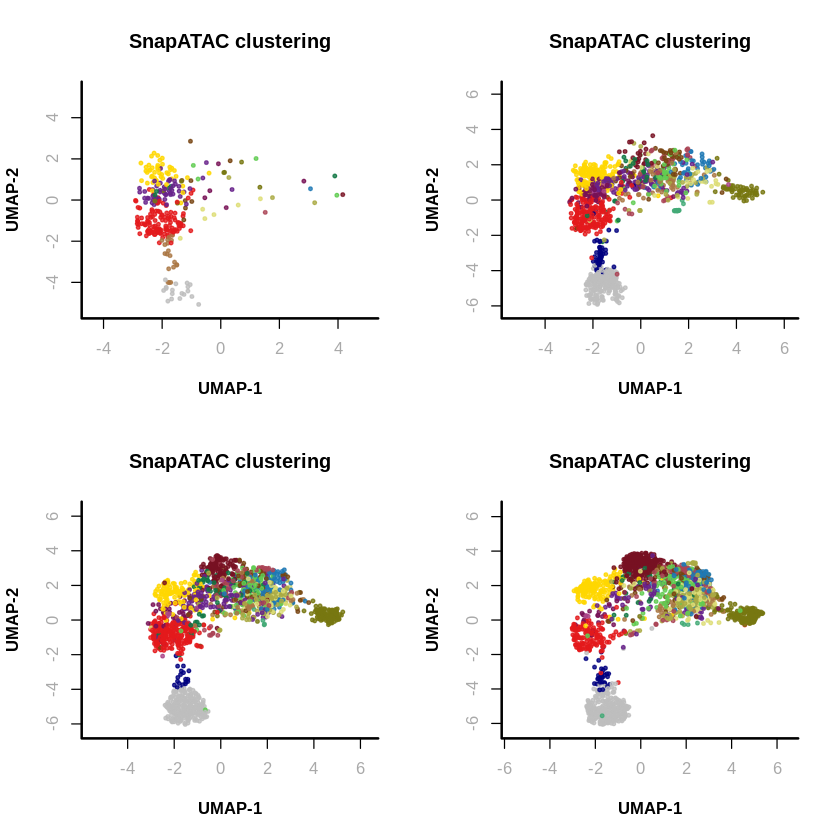

In [17]:

par(mfrow= c(2,2))
plotViz(
    obj=x.sp.fil[x.sp.fil@sample == "TP12",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp.fil[x.sp.fil@sample == "TP12",]@cluster, 
    point.size=0.5, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=FALSE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE
  )
plotViz(
    obj=x.sp.fil[x.sp.fil@sample == "TP13",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp.fil[x.sp.fil@sample == "TP13",]@cluster, 
    point.size=0.5, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=FALSE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE
  )
plotViz(
    obj=x.sp.fil[x.sp.fil@sample == "TP14",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp.fil[x.sp.fil@sample == "TP14",]@cluster, 
    point.size=0.5, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=FALSE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE
  )
plotViz(
    obj=x.sp.fil[x.sp.fil@sample == "TP15",],
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp.fil[x.sp.fil@sample == "TP15",]@cluster, 
    point.size=0.5, 
    point.shape=19, 
    point.alpha=0.8, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=FALSE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE

)

In [476]:
# x.sp.fil <- x.sp.fil[!x.sp.fil@cluster %in% c("12")]
x.sp.fil=runCluster(
    obj=x.sp.fil,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 0.63

)

.
   1    2    3    4    5    6 
1587 1048  942  584  553  379 

In [12]:
# show good transition
# saveRDS(x.sp.fil,file="gonad_fil_onlyknownsomatic.4sampls_snapatac.snap.rds")

x.sp.fil <- readRDS("gonad_fil_onlyknownsomatic.4sampls_snapatac.snap.rds")

In [21]:
## export to archr 
snapumap <- Merged.proj2@cellColData %>% as.data.frame %>% select(umap.1,umap.2)
Merged.proj2@embeddings@listData$UMAP$df$"IterativeLSI#UMAP_Dimension_1" <- snapumap$umap.1 
Merged.proj2@embeddings@listData$UMAP$df$"IterativeLSI#UMAP_Dimension_2" <- snapumap$umap.2 
x.sp.fil@metaData <- cbind(x.sp.fil@metaData[1:25],x.sp.fil@umap,x.sp.fil@smat@dmat[,1:14])
x.sp.fil@metaData <- x.sp.fil@metaData %>% as.data.frame()


x.sp.fil@metaData$cluster <- x.sp.fil@cluster
saveRDS(x.sp.fil@metaData,"gonad_fil.4sampls_snapatac.metadata.rds")



In [290]:
#save RDS and re-load
saveRDS(x.sp.fil,file="gonad_fil2.4sampls_snapatac.snap.rds")
x.sp.fil <- readRDS("gonad_fil2.4sampls_snapatac.snap.rds")

In [480]:
x.sp.fil@metaData <- cbind(x.sp.fil@metaData,x.sp.fil@umap,x.sp.fil@smat@dmat[,1:10])
x.sp.fil@metaData <- x.sp.fil@metaData %>% as.data.frame()


x.sp.fil@metaData$cluster <- x.sp.fil@cluster
saveRDS(x.sp.fil@metaData,"gonad_fil_somatic202112.4sampls_snapatac.metadata.rds")

## Only retain cells from germ cells

In [574]:
x.sp.germ <- x.sp[x.sp@cluster %in% c("8")]
x.sp.germ = addBmatToSnap(x.sp.germ, bin.size=5000, num.cores=1)
x.sp.germ = makeBinary(x.sp.germ, mat="bmat")

Epoch: reading cell-bin count matrix session ...



number of barcodes: 653
number of bins: 546103
number of genes: 9
number of peaks: 0
number of motifs: 0

number of barcodes: 653
number of bins: 545183
number of genes: 9
number of peaks: 0
number of motifs: 0

number of barcodes: 653
number of bins: 468170
number of genes: 9
number of peaks: 0
number of motifs: 0

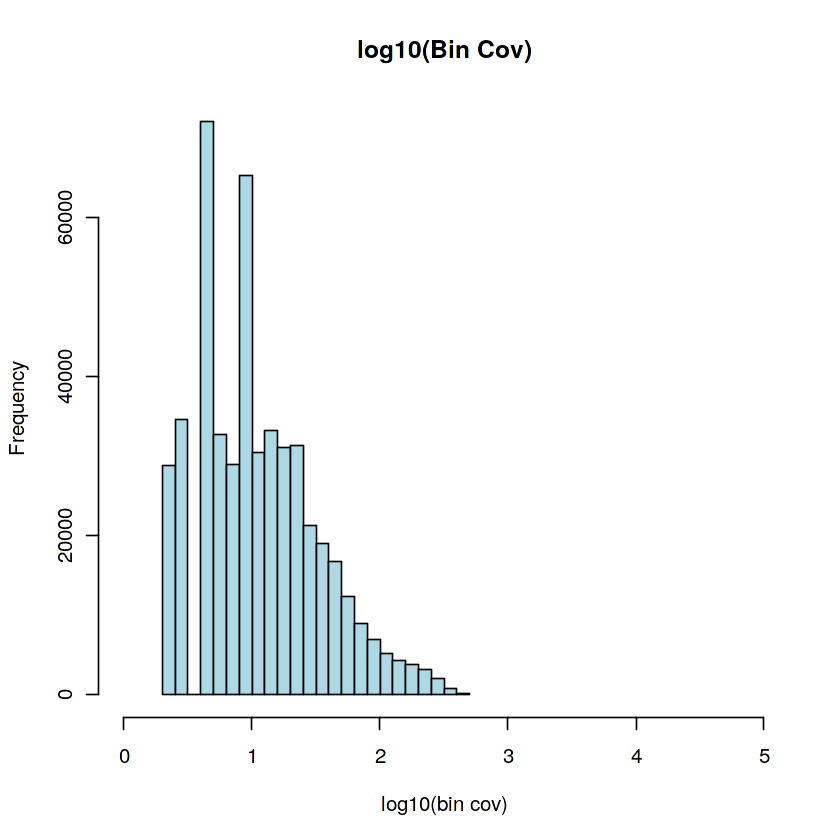

In [575]:
library(GenomicRanges);
# system("wget http://mitra.stanford.edu/kundaje/akundaje/release/blacklists/mm10-mouse/mm10.blacklist.bed.gz")
black_list = read.table("mm10.blacklist.bed.gz");
black_list.gr = GRanges(
    black_list[,1], 
    IRanges(black_list[,2], black_list[,3])
  );
idy = queryHits(findOverlaps(x.sp.germ@feature, black_list.gr));
if(length(idy) > 0){x.sp.germ = x.sp.germ[,-idy, mat="bmat"]};
x.sp.germ
chr.exclude = seqlevels(x.sp.germ@feature)[grep("random|chrM", seqlevels(x.sp.germ@feature))];
idy = grep(paste(chr.exclude, collapse="|"), x.sp.germ@feature);
if(length(idy) > 0){x.sp.germ = x.sp.germ[,-idy, mat="bmat"]};
x.sp.germ
bin.cov = log10(Matrix::colSums(x.sp.germ@bmat)+1)
hist(
    bin.cov[bin.cov > 0], 
    xlab="log10(bin cov)", 
    main="log10(Bin Cov)", 
    col="lightblue", 
    xlim=c(0, 5)
  )
bin.cutoff = quantile(bin.cov[bin.cov > 0], 0.95);
idy = which(bin.cov <= bin.cutoff & bin.cov > 0);
x.sp.germ = x.sp.germ[, idy, mat="bmat"];
x.sp.germ

In [10]:
x.sp.germ = runDiffusionMaps(
    obj=x.sp.germ,
    input.mat="bmat", 
    num.eigs=30
  )
# plotDimReductPW(
#     obj=x.sp.germ, 
#     eigs.dims=1:30,
#     point.size=0.3,
#     point.color="grey",
#     point.shape=19,
#     point.alpha=0.6,
#     down.sample=5000,
#     pdf.file.name=NULL, 
#     pdf.height=7, 
#     pdf.width=7
#   )




In [586]:
x.sp.germ = runKNN(
   obj=x.sp.germ,
   eigs.dims=1:8,
# weight.by.lambda=TRUE,
   k=15
  )

# resolution 0.7 5 cluster
# resolution 0.75 6 cluster


x.sp.germ@metaData$cluster = x.sp.germ@cluster;

x.sp.germ = runViz(
    obj=x.sp.germ, 
    tmp.folder=tempdir(),
    dims=2,
    eigs.dims=1:8, 
    method="Rtsne",
    seed.use=8
  )
x.sp.germ = runViz(
    obj=x.sp.germ, 
    tmp.folder=tempdir(),
    dims=2,
    eigs.dims=1:8, 
    method="umap",
    seed.use=8
  )

In [587]:
# Test cluster number
x.sp.germ=runCluster(
    obj=x.sp.germ,
    tmp.folder=tempdir(),
    louvain.lib="leiden",
    seed.use=10,
    resolution= 0.75

)



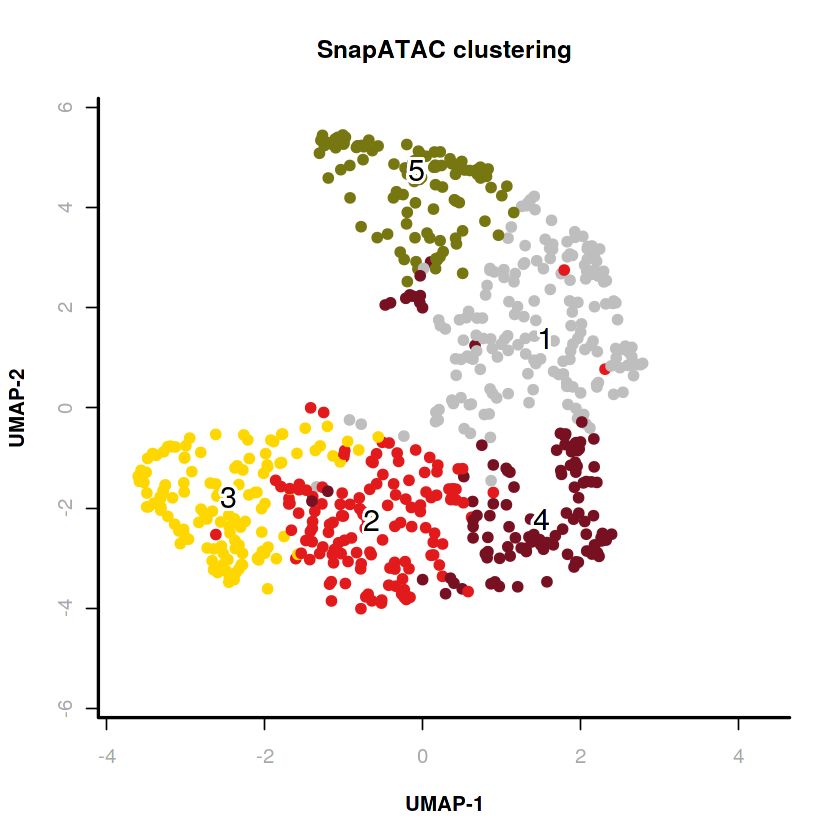

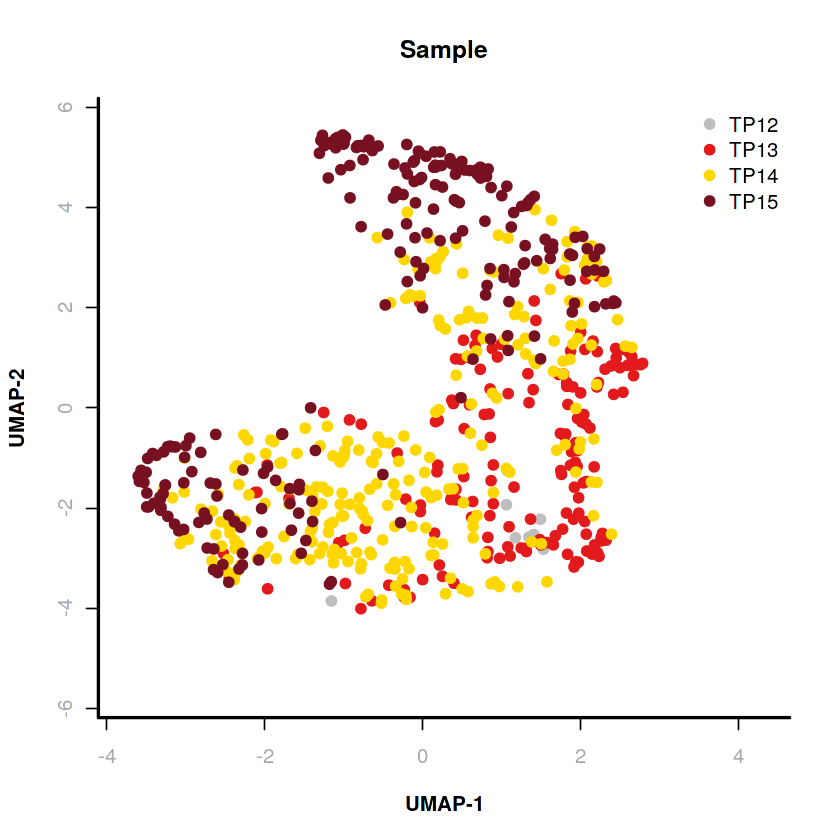

In [588]:
#pdf(file="CTRL.EMT.snap.cluster.summary.v1.pdf")
par(mfrow= c(1,1))
plotViz(
    obj=x.sp.germ,
    method="umap", 
    main="SnapATAC clustering",
    point.color=x.sp.germ@cluster, 
    point.size=1, 
    point.shape=19, 
    point.alpha=1, 
    text.add=TRUE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=FALSE
  )
plotViz(
    obj=x.sp.germ,
    method="umap", 
    main="Sample",
    point.color=x.sp.germ@sample, 
    point.size=1, 
    point.shape=19, 
    point.alpha=1, 
    text.add=FALSE,
    text.size=1.5,
    text.color="black",
    text.halo.add=TRUE,
    text.halo.color="white",
    text.halo.width=0.2,
    down.sample=10000,
    legend.add=TRUE
  )
# plotFeatureSingle(
#     obj=x.sp.germ,
#     feature.value=x.sp.germ@metaData$tssProportion,
#     method="umap", 
#     main="Tss Proportion",
#     point.size=0.3, 
#     point.shape=19, 
#     down.sample=10000,
#     quantiles=c(0, 1) # remove outliers
#   )
# plotFeatureSingle(
#     obj=x.sp.germ,
#     feature.value=x.sp.germ@metaData$uniqueNuclearFrags,
#     method="umap", 
#     main="Number of unique fragments",
#     point.size=0.3, 
#     point.shape=19, 
#     down.sample=10000,
#     quantiles=c(0, 1) # remove outliers
#   )
# #dev.off()




In [589]:
chrY.gr <- GRanges(
    seqnames = c("chrY"),
    ranges = IRanges(1, end = 91744698
                     ),
    strand = c("-"),
    score = 1,
name = "chrY")
chrY.gr

# re-add the cell-by-bin matrix to the snap object;
x.sp.germ = addBmatToSnap(x.sp.germ);
x.sp.germ = createGmatFromMat(
    obj=x.sp.germ, 
    input.mat="bmat",
    genes=chrY.gr,
    do.par=TRUE,
    num.cores=10
  );
# normalize the cell-by-gene matrix
x.sp.germ = scaleCountMatrix(
    obj=x.sp.germ, 
    cov=x.sp.germ@metaData$nFrags,
    mat="gmat",
    method = "RPM"
  )

# x.sp.germ = runMagic(
#     obj=x.sp.germ,
#     input.mat="gmat",
#     step.size=3
#   );

GRanges object with 1 range and 2 metadata columns:
      seqnames     ranges strand |     score        name
         <Rle>  <IRanges>  <Rle> | <numeric> <character>
  [1]     chrY 1-91744698      - |         1        chrY
  -------
  seqinfo: 1 sequence from an unspecified genome; no seqlengths

Epoch: reading cell-bin count matrix session ...



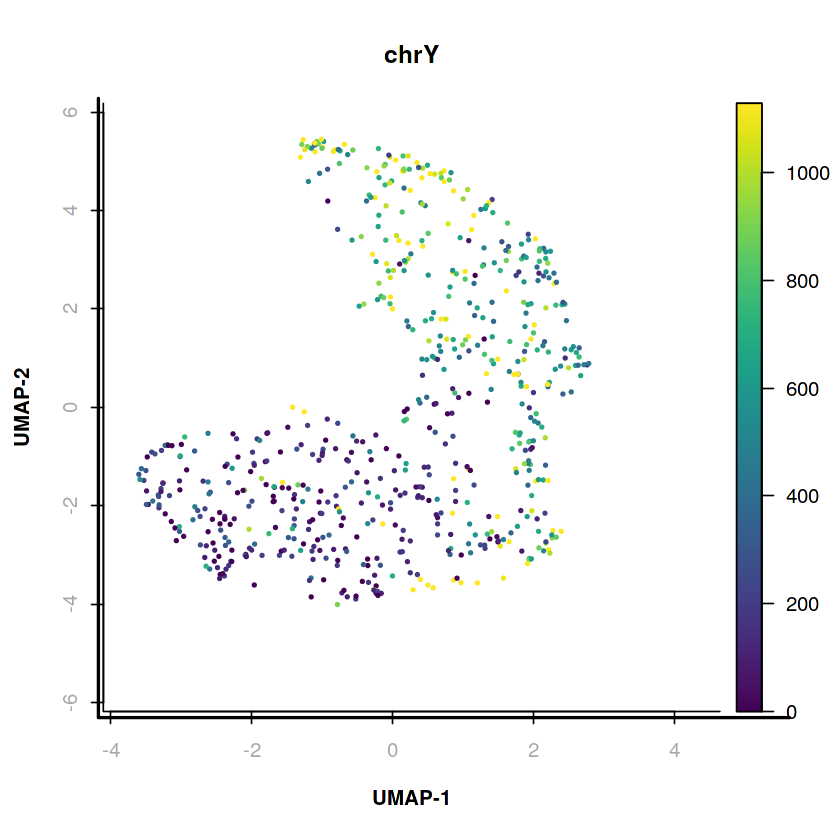

In [594]:
plotFeatureSingle(
    obj=x.sp.germ,
    feature.value=x.sp.germ@gmat[, "chrY"],
    method="umap", 
    main="chrY",
    point.size=0.3, 
    point.shape=19, 
    down.sample=10000,
    quantiles=c(0, 0.9) # remove outliers
  )

In [591]:
saveRDS(x.sp.germ,file="gonad_germ.4sampls_snapatac.snap.rds")

In [601]:
# chrY.quant <- as.matrix(x.sp.fil@gmat) %>% as.data.frame()
germ.chrY <- as.matrix(x.sp.germ@gmat[, "chrY"]) %>% as.data.frame()
# saveRDS(chrY.quant,file="ChrY.quant.snap.rds")

# x.sp.fil@metaData <- 
x.sp.germ@metaData <- cbind(x.sp.germ@metaData,chrY=germ.chrY)

x.sp.germ@metaData$chrY <- x.sp.germ@metaData$V1
x.sp.germ@metaData$V1 <- NULL


In [605]:
saveRDS(x.sp.germ@metaData,"gonad_germ.4sampls_snapatac.metadata.rds")

In [593]:
## export to archr 
# snapumap <- Merged.proj2@cellColData %>% as.data.frame %>% select(umap.1,umap.2)
# Merged.proj2@embeddings@listData$UMAP$df$"IterativeLSI#UMAP_Dimension_1" <- snapumap$umap.1 
# Merged.proj2@embeddings@listData$UMAP$df$"IterativeLSI#UMAP_Dimension_2" <- snapumap$umap.2 
x.sp.germ@metaData <- cbind(x.sp.germ@metaData,x.sp.germ@umap,x.sp.germ@smat@dmat[,1:8])
x.sp.germ@metaData <- x.sp.germ@metaData %>% as.data.frame()


x.sp.germ@metaData$cluster <- x.sp.germ@cluster
saveRDS(x.sp.germ@metaData,"gonad_germ.4sampls_snapatac.metadata.rds")

